# Análise Exploratória - Variável TimeFixBug
bug-fixing time (dependent): the total amount of time required to fix a bug.

# Importações

In [1]:
#Manipulação de Dados
import pandas as pd
import numpy as np
from datetime import datetime

#Visualização de Dados
import matplotlib.pyplot as plt
import seaborn as sb
#from pandas_profiling import ProfileReport


In [2]:
# Permitir exibição dos plots no Jupyter Notebook
%matplotlib inline

In [3]:
# Exibir todas as colunas no head
pd.set_option('display.max_columns', None)

In [4]:
!pip install  tk

# Carregamento dos Dados

In [7]:
changelog_file = pd.read_csv("../data/raw/new_changelog_file.csv", sep = ",")
commit_file = pd.read_csv("../data/raw/new_commit_file.csv", sep = ",")
comment_file = pd.read_csv("../data/raw/new_comment_file.csv", sep = ",")
final_list_of_contributors = pd.read_csv("../data/raw/final_list_of_contributors_after.csv", sep = ";")
snapshot_file = pd.read_csv("../data/raw/new_snapshot_file.csv", sep = ",")



# Tranformações e Manipulações de Dados

In [8]:
snapshot_file.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73293 entries, 0 to 73292
Data columns (total 53 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   Project                    73293 non-null  object
 1   Owner                      73293 non-null  object
 2   Manager                    73293 non-null  object
 3   Category                   73293 non-null  object
 4   Key                        73293 non-null  object
 5   Priority                   73292 non-null  object
 6   Status                     73293 non-null  object
 7   Reporter                   73271 non-null  object
 8   Assignee                   65176 non-null  object
 9   Components                 46592 non-null  object
 10  SummaryTopWords            72633 non-null  object
 11  DescriptionTopWords        68968 non-null  object
 12  CommentsTopWords           70286 non-null  object
 13  CreationDate               73293 non-null  object
 14  Resolu

In [9]:
snapshot_file.head(5)

,Project,Owner,Manager,Category,Key,Priority,Status,Reporter,Assignee,Components,SummaryTopWords,DescriptionTopWords,CommentsTopWords,CreationDate,ResolutionDate,AffectsVersions,FixVersions,NoComments,FirstCommentDate,LastCommentDate,NoWatchers,NoAttachments,FirstAttachmentDate,LastAttachmentDate,NoAttachedPatches,FirstAttachedPatchDate,LastAttachedPatchDate,InwardIssueLinks,OutwardIssueLinks,HasMergeCommit,CommitsMessagesTopWords,NoCommits,NoAuthors,NoCommitters,AuthorsFirstCommitDate,AuthorsLastCommitDate,CommittersFirstCommitDate,CommittersLastCommitDate,NonSrcAddFiles,NonSrcDelFiles,NonSrcModFiles,NonSrcAddLines,NonSrcDelLines,SrcAddFiles,SrcDelFiles,SrcModFiles,SrcAddLines,SrcDelLines,TestAddFiles,TestDelFiles,TestModFiles,TestAddLines,TestDelLines
0,BUILDR,ASF,Apache Buildr Committee,build-management,BUILDR-235,Trivial,Closed,alexismidon,NaN,JRuby Site/documentation,download:1 link:1 broken:1,download:1 link:1 valid:1 install:1,NaN,2009-01-07 20:26:20,2009-03-12 22:52:51,1.3.3,1.3.4,0,NaN,NaN,0,1,2009-01-07 20:27:04.874,2009-01-07 20:27:04.874,1,2009-01-07 20:27:04.874,2009-01-07 20:27:04.874,NaN,NaN,0,fixed:1 download:1 link:1 broke:1 git:1 id:1 h...,1,1,1,2009-03-12 23:35:27+00:00,2009-03-12 23:35:27+00:00,2009-03-12 23:35:27+00:00,2009-03-12 23:35:27+00:00,0,0,1,1,0,0,0,1,1,1,0,0,0,0,0
1,BUILDR,ASF,Apache Buildr Committee,build-management,BUILDR-236,Major,Closed,alexismidon,NaN,NaN,misssing:1 console:1 ant:1,ant:3 derby:2 task:2 issue:2 console:1 message...,fixed:2 upgraded:1 maybe:1 try:1 messages:1 lo...,2009-01-14 00:35:08,2010-02-28 15:45:40,1.3.3,1.4,3,2010-02-28 07:02:33.705,2010-02-28 15:45:40.74,0,1,2009-01-14 00:51:58.11,2009-01-14 00:51:58.11,0,NaN,NaN,NaN,NaN,0,NaN,0,0,0,NaT,NaT,NaT,NaT,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,BUILDR,ASF,Apache Buildr Committee,build-management,BUILDR-239,Major,Closed,jmuzz,NaN,Core features,http:1 redirects:1 lose:1 authentication:1 inf...,authentication:2 request:2 url:2 new:2 uses:1 ...,patch:2 fix:1 bug:1 spec:1,2009-01-29 00:44:50,2009-03-12 23:20:28,1.3.3,1.3.4,2,2009-01-29 00:57:54.349,2009-01-29 20:25:32.547,0,2,2009-01-29 00:57:54.255,2009-01-29 20:25:32.522,2,2009-01-29 00:57:54.255,2009-01-29 20:25:32.522,NaN,NaN,0,fixed:1 http:1 redirects:1 lose:1 authenticati...,1,1,1,2009-03-12 23:42:37+00:00,2009-03-12 23:42:37+00:00,2009-03-12 23:42:37+00:00,2009-03-12 23:42:37+00:00,0,0,1,2,0,0,0,2,27,1,0,0,0,0,0
3,BUILDR,ASF,Apache Buildr Committee,build-management,BUILDR-241,Major,Closed,rsutphin,NaN,IDE,generation:1 pay:1 attention:1,h:3 file:3 project:2 like:2 define:2 alphabet:...,patch:2 git:1 formatted:1 issue:1 includes:1 s...,2009-02-04 17:19:01,2009-03-12 23:29:19,1.3.3,1.3.4,1,2009-02-04 19:37:19.189,2009-02-04 19:37:19.189,0,1,2009-02-04 19:37:19.165,2009-02-04 19:37:19.165,1,2009-02-04 19:37:19.165,2009-02-04 19:37:19.165,NaN,NaN,0,git:2 id:2 https:2 apache:2 trunk:2 fixed:1 ge...,2,1,1,2009-03-12 23:47:00+00:00,2009-03-13 02:50:15+00:00,2009-03-12 23:47:00+00:00,2009-03-13 02:50:15+00:00,0,0,1,2,0,2,0,1,153,2,0,0,0,0,0
4,BUILDR,ASF,Apache Buildr Committee,build-management,BUILDR-243,Minor,Closed,digitalsanctum,NaN,Compilers,unrecognized:1 option:1 silent:1,silent:2 option:2 page:1 building:1 refers:1 a...,back:1 working:1,2009-02-06 21:40:44,2009-02-15 01:43:54,1.3.3,1.3.4,1,2009-02-09 06:54:05.416,2009-02-09 06:54:05.416,0,0,NaN,NaN,0,NaN,NaN,NaN,NaN,0,NaN,0,0,0,NaT,NaT,NaT,NaT,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [25]:
profile = ProfileReport(snapshot_file, title="Pandas Profiling Report")
profile

Render HTML: 100%|██████████| 1/1 [00:09<00:00,  9.46s/it]


x : Variável que não pode ser utilizada

? : Dúvidas sobre a utilidade da variável

V : Variável que pode ser utilizada

  : Indiferente

### Variáveis

V - Variável Project: Possui uma distribuição quase que homogenea entre as classes que o compõe, não possui nenhuma classe com frequência muito acima ou muito abaixo das demais. Boa parte dos registros envolvem o projeto HDFS.

x - Variáveis Owner, Manager e Category: são preenchidas por um único valor, não fazendo sentido analisar / utilizar elas.

x - Variável Key: Todos os registros possuem um key distinta e única. 

V - Variável Prority: A classe mais frequente/presente é a Major. A menor de todas é a Trivial. Existe uma distribuição mais homogênea entre as classes Minor, Blocker e Critical.

V - Variável Status: Possui apenas duas classes, distribuidos de forma mais homogênea, sendo mais frequente a classe Closed.

V - Variável Reporter: Possui uma alta quantidade de classes, aparentemente tendo uma distribuição pouso desbalanceada entre as classes. A classe mais presente é o id113.

? - Variável Assignee: Possui uma alta quantidade de classes, aparentemente tendo uma distribuição pouso desbalanceada entre as classes. No entanto, existe um valor -1, que chama atenção, sendo a mais frequente, inclusive.

? - Variável Components: Possui várias classes, tendo maior presença da classe test. Tem 30% dos dados como NaN.

V - Variável SummaryTopWords: Possui várias classes. Pouco valor nulo.

V - Variável DescriptionTopWords: Possui várias classes. Pouco valor nulo.

V - Variável CommentsTopWords: Possui várias classes. Pouco valor nulo.

V - Variável CreationDate: Variável temporal, nenhum valor nulo.

V - Variável ResolutionDate: Variável temporal, nenhum valor nulo.

x - Variável AffectsVersions: Variável categórica, como ela informa uma versão que foi afetada pela atualização, talvez não seja útil. Possui muitas variáveis nulas.

x - Variável FixVersions: Variável categórica, como ela informa uma versão que foi afetada pela atualização, talvez não seja útil.

V - Variável NoComments: Variável numérica, sem dados nulos. Média 15.

V - Variável FirstCommentDate: Variável temporal, nenhum valor nulo.

V - Variável LastCommentDate: Variável temporal, nenhum valor nulo.

x - Variável NoWatchers: Preenchido por um único valor. 

V - NoAttachments: Variável numérica, sem dados nulos. Média: 2.65.

V - Variável FirstAttachmentDate: Variável temporal, poucos dados nulos. (Os nulos provavelmente os registros que não possuem Attachments, ou seja, =0)

V - Variável LastAttachmentDate: Variável temporal, poucos dados nulos. 

V - NoAttachedPatches: Variável numérica, sem dados nulos. Média: 2.40.

V - Variável FirstAttachedPatchDate: Variável temporal, poucos dados nulos. (Os nulos provavelmente os registros que não possuem AttachedPatches, ou seja, =0)

V - Variável LastAttachedPatchDate: Variável temporal, poucos dados nulos. 

x - Variável InwardIssueLinks: Variável com muitos valores nulos.

x - Variável OutwardIssueLinks: Variável com muitos valores nulos.

x - Variável HasMergeCommit: Variável praticamente preenchida por um único valor.

V - Variável CommitsMessagesTopWords: Possui várias classes. Pouco valor nulo.

V - Variável NoCommits: Variável numérica, com nenhum valor NaN. Média: 0.85.

V - Variável NoAuthors: Variável categórica (será convertida em numérica), com concentração do valor 1. 

V - Variável NoCommitters: Variável categórica (será convertida em numérica), com concentração do valor 1. 

V - Variável AuthorsFirstCommitDate: Variável temporal, nenhum valor nulo.

V - Variável AuthorsLastCommitDate: Variável temporal, nenhum valor nulo.

V - Variável CommittersFirstCommitDate: Variável temporal, nenhum valor nulo.

V - Variável CommittersLastCommitDate: Variável temporal, nenhum valor nulo.

V - Variável NonSrcAddFiles: Variável numérica, com nenhum valor NaN. Média: 0.05.

V - Variável NonSrcDelFiles: Variável numérica, com nenhum valor NaN. Média: 0.01.

V - Variável NonSrcModFiles: Variável numérica, com nenhum valor NaN. Média: 0.88.

V - Variável NonSrcAddLines: Variável numérica, com nenhum valor NaN. Média: 30.21.

V - Variável NonSrcDelLines: Variável numérica, com nenhum valor NaN. Média: 8.06.

V - Variável SrcAddFiles: Variável numérica, com nenhum valor NaN. Média: 0.04.

V - Variável SrcDelFiles: Variável numérica, com nenhum valor NaN. Média: 0.01.

V - Variável SrcModFiles: Variável numérica, com nenhum valor NaN. Média: 1.40.

V - Variável SrcAddLines: Variável numérica, com nenhum valor NaN. Média: 22.63.

V - Variável SrcDelLines: Variável numérica, com nenhum valor NaN. Média: 12.35.

V - Variável TestAddFiles: Variável numérica, com nenhum valor NaN. Média: 0.05.

V - Variável TestDelFiles: Variável numérica, com nenhum valor NaN. Média: 0.02.

V - Variável TestModFiles: Variável numérica, com nenhum valor NaN. Média: 0.77.

V - Variável TestAddLines: Variável numérica, com nenhum valor NaN. Média: 25.62.

V - Variável TestDelLines: Variável numérica, com nenhum valor NaN. Média: 9.21.


Dúvidas:

- Qual a diferença entre Authors e Commiters? Eles representam a mesma coisa?


### Seleção de Features

In [10]:
snapshot_file.drop(columns = ["Owner", "Manager", "Category", "AffectsVersions", "FixVersions", "NoWatchers", "InwardIssueLinks", "OutwardIssueLinks", "HasMergeCommit"], inplace = True)

### Trato na Tipagem dos Dados

In [11]:
snapshot_file.NoAuthors = snapshot_file.NoAuthors.astype("int")
snapshot_file.NoCommitters = snapshot_file.NoCommitters.astype("int")

### Engenharia de Features

#### TimeFixBug

In [12]:
# Criação do TimeFixBug para estimar o tempo de resolução do bug em horas.
snapshot_file["ResolutionDate"] = pd.to_datetime(snapshot_file["ResolutionDate"])
snapshot_file["CreationDate"] = pd.to_datetime(snapshot_file["CreationDate"])
snapshot_file["TimeFixBug"] = ((snapshot_file["ResolutionDate"] - snapshot_file["CreationDate"]).dt.days)

In [13]:
snapshot_file["TimeFixBug"].describe() 

count    73293.000000
mean        66.429168
std        204.964121
min          0.000000
25%          0.000000
50%          5.000000
75%         31.000000
max       3372.000000
Name: TimeFixBug, dtype: float64

50% das correções de bug levaram até 168 horas para ser resolvidos, uma estimativa de 7 dias. Enquanto, 75% das correções demandaram até 936 horas para serem resolvidos, cerca de 39 dias. 

##### Estudando distribuição e verificando outlier

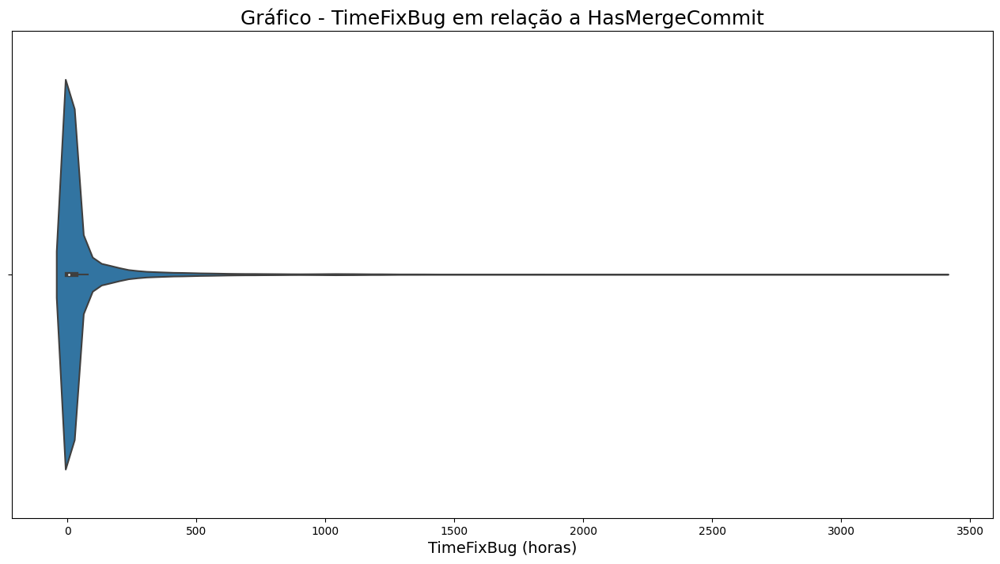

In [14]:
ax = sb.violinplot(x = 'TimeFixBug', data = snapshot_file)
ax.figure.set_size_inches(16, 8)
ax.set_xlabel('TimeFixBug (horas)', fontsize=14)
plt.title('Gráfico - TimeFixBug em relação a HasMergeCommit', fontsize=18)
plt.show()

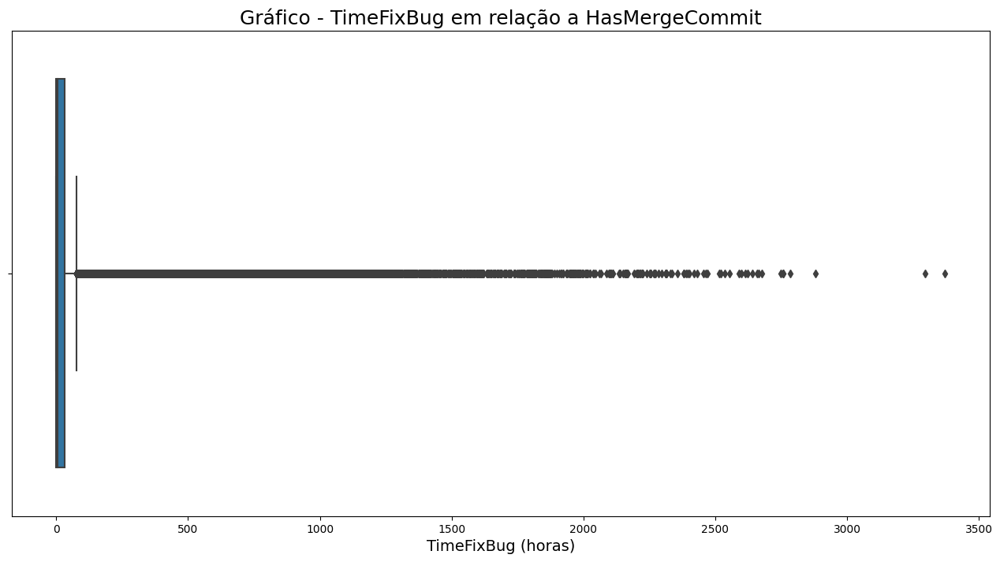

In [15]:
ax = sb.boxplot(x = 'TimeFixBug', data = snapshot_file)
ax.figure.set_size_inches(16, 8)
ax.set_xlabel('TimeFixBug (horas)', fontsize=14)
plt.title('Gráfico - TimeFixBug em relação a HasMergeCommit', fontsize=18)
plt.show()

##### Remoção de Outliers

Realizando o cálculo do intervalo interquartil: 936 - 24 = 912
Calculando o limite superior: 912 +(1.5 * 936) = 2316
Ou seja, tudo que for superior a 2316 é considerado outlier. Isso é equivalente a 97 dias, aproximadamente, de trabalho.

Realizando o cálculo do intervalo interquartil: 39 - 1 = 38
Calculando o limite superior: 38 + (1.5 * 38) = 95
Ou seja, tudo que for superior a 95 é considerado outlier, o que representa 95 dias.

In [16]:
snapshot_file_without_outlier = snapshot_file[snapshot_file.TimeFixBug <= 95] 

# Análises

## Verificaração de relação / correlação entre variáveis numéricas com a variável TimeFixBug

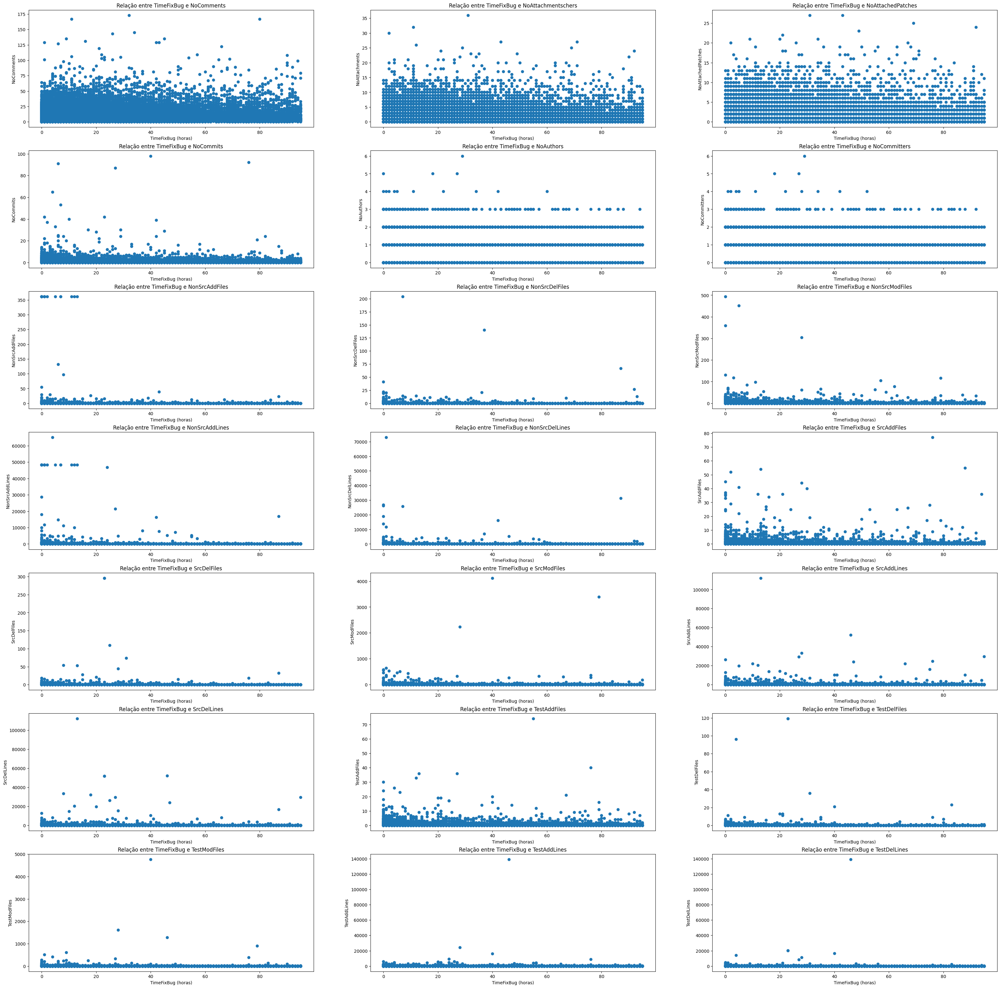

In [17]:
fig, axes = plt.subplots(7, 3, figsize = (40, 40))
axes[0, 0].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NoComments)
axes[0, 0].set_title("Relação entre TimeFixBug e NoComments")
axes[0, 0].set_xlabel("TimeFixBug (horas)")
axes[0, 0].set_ylabel("NoComments")

axes[0, 1].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NoAttachments)
axes[0, 1].set_title("Relação entre TimeFixBug e NoAttachmentschers")
axes[0, 1].set_xlabel("TimeFixBug (horas)")
axes[0, 1].set_ylabel("NoAttachments")

axes[0, 2].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NoAttachedPatches)
axes[0, 2].set_title("Relação entre TimeFixBug e NoAttachedPatches")
axes[0, 2].set_xlabel("TimeFixBug (horas)")
axes[0, 2].set_ylabel("NoAttachedPatches")

axes[1, 0].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NoCommits)
axes[1, 0].set_title("Relação entre TimeFixBug e NoCommits")
axes[1, 0].set_xlabel("TimeFixBug (horas)")
axes[1, 0].set_ylabel("NoCommits")

axes[1, 1].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NoAuthors)
axes[1, 1].set_title("Relação entre TimeFixBug e NoAuthors")
axes[1, 1].set_xlabel("TimeFixBug (horas)")
axes[1, 1].set_ylabel("NoAuthors")

axes[1, 2].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NoCommitters)
axes[1, 2].set_title("Relação entre TimeFixBug e NoCommitters")
axes[1, 2].set_xlabel("TimeFixBug (horas)")
axes[1, 2].set_ylabel("NoCommitters")

axes[2, 0].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NonSrcAddFiles)
axes[2, 0].set_title("Relação entre TimeFixBug e NonSrcAddFiles")
axes[2, 0].set_xlabel("TimeFixBug (horas)")
axes[2, 0].set_ylabel("NonSrcAddFiles")

axes[2, 1].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NonSrcDelFiles)
axes[2, 1].set_title("Relação entre TimeFixBug e NonSrcDelFiles")
axes[2, 1].set_xlabel("TimeFixBug (horas)")
axes[2, 1].set_ylabel("NonSrcDelFiles")

axes[2, 2].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NonSrcModFiles)
axes[2, 2].set_title("Relação entre TimeFixBug e NonSrcModFiles")
axes[2, 2].set_xlabel("TimeFixBug (horas)")
axes[2, 2].set_ylabel("NonSrcModFiles")

axes[3, 0].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NonSrcAddLines)
axes[3, 0].set_title("Relação entre TimeFixBug e NonSrcAddLines")
axes[3, 0].set_xlabel("TimeFixBug (horas)")
axes[3, 0].set_ylabel("NonSrcAddLines")

axes[3, 1].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.NonSrcDelLines)
axes[3, 1].set_title("Relação entre TimeFixBug e NonSrcDelLines")
axes[3, 1].set_xlabel("TimeFixBug (horas)")
axes[3, 1].set_ylabel("NonSrcDelLines")

axes[3, 2].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.SrcAddFiles)
axes[3, 2].set_title("Relação entre TimeFixBug e SrcAddFiles")
axes[3, 2].set_xlabel("TimeFixBug (horas)")
axes[3, 2].set_ylabel("SrcAddFiles")

axes[4, 0].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.SrcDelFiles)
axes[4, 0].set_title("Relação entre TimeFixBug e SrcDelFiles")
axes[4, 0].set_xlabel("TimeFixBug (horas)")
axes[4, 0].set_ylabel("SrcDelFiles")

axes[4, 1].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.SrcModFiles)
axes[4, 1].set_title("Relação entre TimeFixBug e SrcModFiles")
axes[4, 1].set_xlabel("TimeFixBug (horas)")
axes[4, 1].set_ylabel("SrcModFiles")

axes[4, 2].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.SrcAddLines)
axes[4, 2].set_title("Relação entre TimeFixBug e SrcAddLines")
axes[4, 2].set_xlabel("TimeFixBug (horas)")
axes[4, 2].set_ylabel("SrcAddLines")

axes[5, 0].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.SrcDelLines)
axes[5, 0].set_title("Relação entre TimeFixBug e SrcDelLines")
axes[5, 0].set_xlabel("TimeFixBug (horas)")
axes[5, 0].set_ylabel("SrcDelLines")

axes[5, 1].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.TestAddFiles)
axes[5, 1].set_title("Relação entre TimeFixBug e TestAddFiles")
axes[5, 1].set_xlabel("TimeFixBug (horas)")
axes[5, 1].set_ylabel("TestAddFiles")

axes[5, 2].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.TestDelFiles)
axes[5, 2].set_title("Relação entre TimeFixBug e TestDelFiles")
axes[5, 2].set_xlabel("TimeFixBug (horas)")
axes[5, 2].set_ylabel("TestDelFiles")

axes[6, 0].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.TestModFiles)
axes[6, 0].set_title("Relação entre TimeFixBug e TestModFiles")
axes[6, 0].set_xlabel("TimeFixBug (horas)")
axes[6, 0].set_ylabel("TestModFiles")

axes[6, 1].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.TestAddLines)
axes[6, 1].set_title("Relação entre TimeFixBug e TestAddLines")
axes[6, 1].set_xlabel("TimeFixBug (horas)")
axes[6, 1].set_ylabel("TestAddLines")

axes[6, 2].scatter(snapshot_file_without_outlier.TimeFixBug, snapshot_file_without_outlier.TestDelLines)
axes[6, 2].set_title("Relação entre TimeFixBug e TestDelLines")
axes[6, 2].set_xlabel("TimeFixBug (horas)")
axes[6, 2].set_ylabel("TestDelLines")

plt.show()

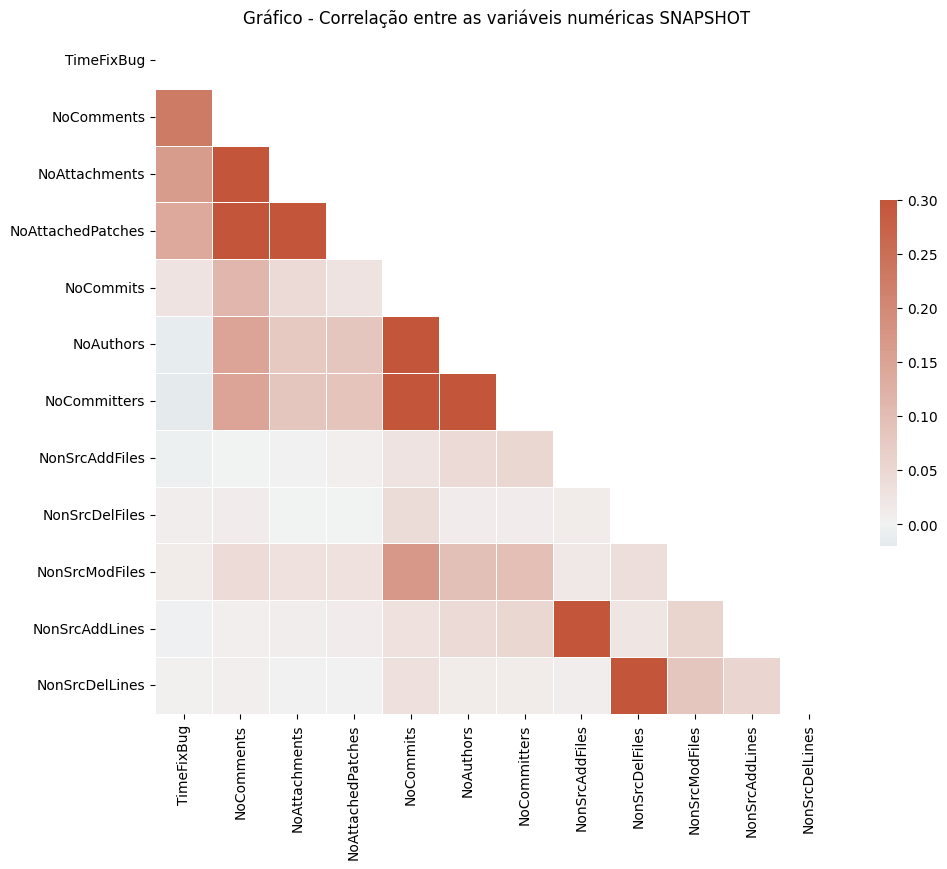

In [18]:
correlacao_snapshot = snapshot_file_without_outlier[["TimeFixBug", "NoComments", "NoAttachments", "NoAttachedPatches", "NoCommits", "NoAuthors", "NoCommitters", 
                            "NonSrcAddFiles", "NonSrcDelFiles", "NonSrcModFiles", "NonSrcAddLines", "NonSrcDelLines"]]
corr = correlacao_snapshot.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sb.diverging_palette(230, 20, as_cmap=True)
sb.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.title('Gráfico - Correlação entre as variáveis numéricas SNAPSHOT')
plt.savefig("../reports/figures/corr_snapshot.png")
plt.show()

- Nenhuma correlação forte foi notada entre alguma variável e a TimeFixBug.
- A maior correlção mais observa é de 0.3 entre a TimeFixBug e as variáveis NoComments, NoAttachments e NoAttachedPatches.
- As correlações perceptívas são um pouco obvias: quanto maior o número de autores, maior o número de comentários, por exemplo.

## Verificaração de relação / correlação entre variáveis categóricas com a variável TimeFixBug

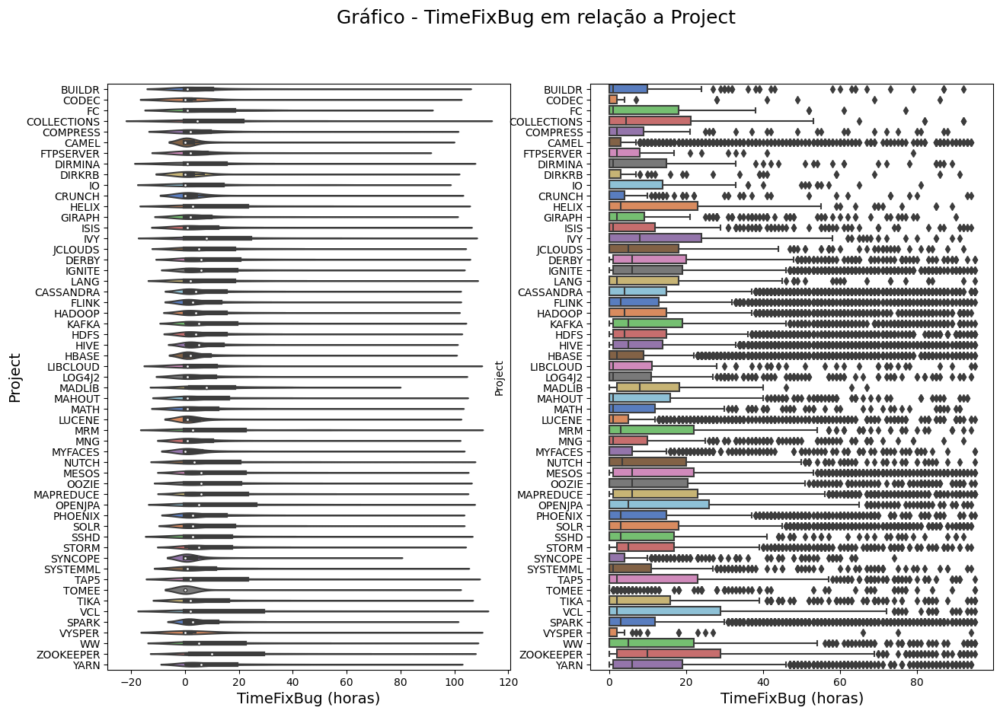

In [19]:
fig, axes = plt.subplots(1, 2, figsize = (15, 10))

sb.violinplot(x = 'TimeFixBug', y = 'Project',
                data = snapshot_file_without_outlier, 
                palette = "muted",
                ax = axes[0])
axes[0].set_xlabel('TimeFixBug (horas)', fontsize = 14)
axes[0].set_ylabel('Project', fontsize = 14) 

sb.boxplot(x = 'TimeFixBug', y = 'Project',
                data = snapshot_file_without_outlier, 
                palette = "muted",
                ax = axes[1])
axes[1].set_xlabel('TimeFixBug (horas)', fontsize = 14)

fig.suptitle('Gráfico - TimeFixBug em relação a Project', fontsize = 18)
plt.show()

De acordo com o projeto, percebemos que o projeto MapReduce e Yarn demandaram mais tempo, no geral, do que os FixBugs que envolveram o Hadoop e HDFS.

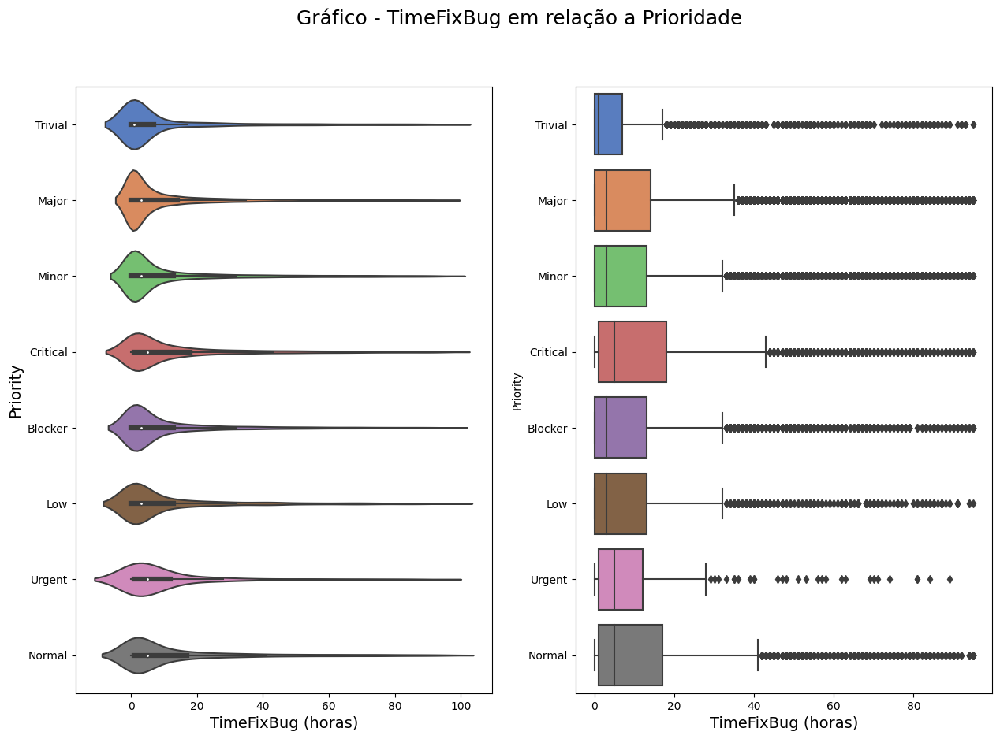

In [20]:
fig, axes = plt.subplots(1, 2, figsize = (15, 10))

sb.violinplot(x = 'TimeFixBug', y = 'Priority',
                data = snapshot_file_without_outlier, 
                palette = "muted", 
                ax = axes[0])
axes[0].set_xlabel('TimeFixBug (horas)', fontsize = 14)
axes[0].set_ylabel('Priority', fontsize = 14) 

sb.boxplot(x = 'TimeFixBug', y = 'Priority',
                data = snapshot_file_without_outlier, 
                palette = "muted",
                ax = axes[1])
axes[1].set_xlabel('TimeFixBug (horas)', fontsize = 14)

fig.suptitle('Gráfico - TimeFixBug em relação a Prioridade', fontsize = 18)
plt.show()

Aparentemente as prioridades Major e Critical demandaram mais tempo que as demais prioridades, podemos comparar em relação a mediana e ao 3° quartil que são maiores comparados as outras classes. A prioridade Trivial possuem, no geral, um tempo de TimeFixBug menor que as demais classes.

In [21]:
#Selecionando as linhas com apenas os 10 Reporter mais frequentes
snapshot_10reporters = snapshot_file_without_outlier.loc[snapshot_file_without_outlier['Reporter'].isin(snapshot_file_without_outlier['Reporter'].value_counts()[:10].index.tolist()
)]


In [22]:
snapshot_10reporters.describe()

,CreationDate,ResolutionDate,NoComments,NoAttachments,NoAttachedPatches,NoCommits,NoAuthors,NoCommitters,NonSrcAddFiles,NonSrcDelFiles,NonSrcModFiles,NonSrcAddLines,NonSrcDelLines,SrcAddFiles,SrcDelFiles,SrcModFiles,SrcAddLines,SrcDelLines,TestAddFiles,TestDelFiles,TestModFiles,TestAddLines,TestDelLines,TimeFixBug
count,4865,4865,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000,4865.000000
mean,2013-12-17 09:17:52.034943488,2013-12-24 10:43:27.723124480,7.593834,1.412333,0.938129,0.996300,0.798356,0.799178,0.022199,0.030421,0.554368,5.309558,9.223227,0.100308,0.029394,2.854265,77.886331,44.772867,0.179856,0.012333,1.129085,30.968140,10.763618,6.749229
min,2009-01-02 17:13:09,2009-01-05 15:11:32,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2012-02-14 03:46:18,2012-02-18 01:21:11,2.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2014-06-09 11:17:08,2014-06-09 11:19:17,5.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,5.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2015-09-27 14:59:58,2015-10-06 18:45:49,10.000000,2.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,2.000000,29.000000,12.000000,0.000000,0.000000,1.000000,8.000000,0.000000,5.000000
max,2018-12-27 05:26:04,2018-12-28 22:49:07,106.000000,32.000000,20.000000,40.000000,3.000000,3.000000,12.000000,41.000000,359.000000,4450.000000,26840.000000,28.000000,13.000000,431.000000,29415.000000,29391.000000,18.000000,6.000000,614.000000,3131.000000,4626.000000,95.000000
std,NaN,NaN,9.460611,1.996237,1.630329,1.098363,0.479683,0.481311,0.310057,0.733298,5.498726,76.353968,388.410917,0.684210,0.351453,11.616753,736.522730,504.349336,0.752139,0.160476,11.048682,132.869136,106.583033,15.248935


In [23]:
snapshot_10reporters.Reporter.value_counts()

Reporter
stack                  722
github-import          614
davsclaus              592
yuzhihong@gmail.com    523
sershe                 499
rcmuir                 454
romain.manni-bucau     413
jamestaylor            397
jbellis                339
tlipcon                312
Name: count, dtype: int64

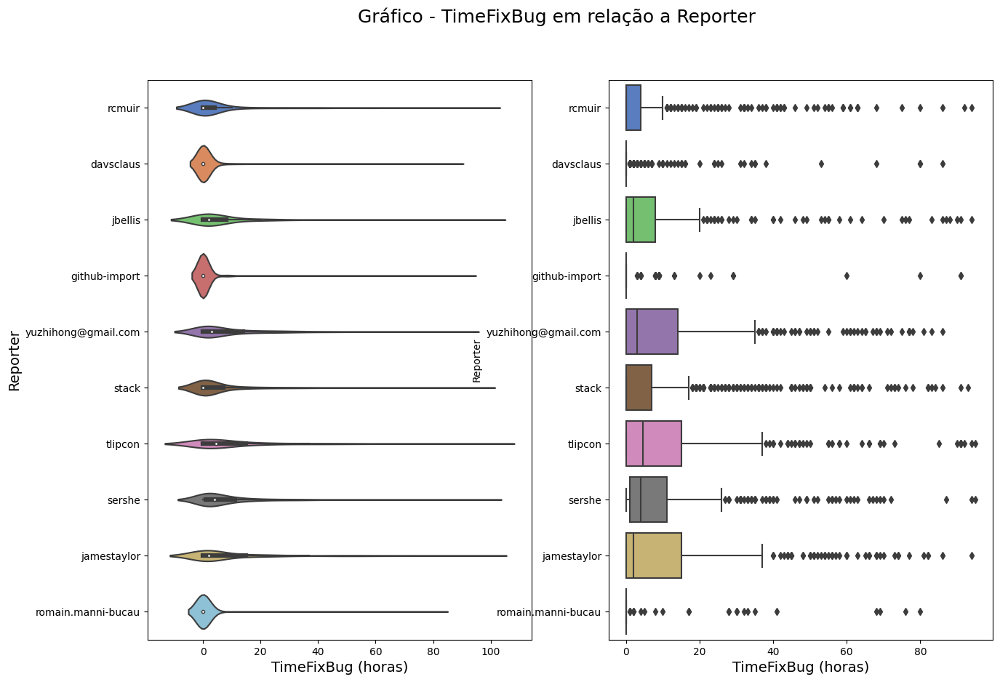

In [24]:
fig, axes = plt.subplots(1, 2, figsize = (15, 10))

sb.violinplot(x = 'TimeFixBug', y = 'Reporter',
                data = snapshot_10reporters, 
                palette = "muted", 
                ax = axes[0])
axes[0].set_xlabel('TimeFixBug (horas)', fontsize = 14)
axes[0].set_ylabel('Reporter', fontsize = 14) 

sb.boxplot(x = 'TimeFixBug', y = 'Reporter',
                data = snapshot_10reporters, 
                palette = "muted",
                ax = axes[1])
axes[1].set_xlabel('TimeFixBug (horas)', fontsize = 14)

fig.suptitle('Gráfico - TimeFixBug em relação a Reporter', fontsize = 18)
plt.show()

Observando, o Reporter, o id88 é que reportou atividades, no geral, com menor TimeFixBug. Outros ids em destaque de menor TimeFixBug é id263 e id644. Essa seleção foi observando a mediana e o 3° quartil. Destaque para o id88 e id113 que são os 3 Reporters mais frequentes.

In [26]:
#Selecionando as linhas com apenas os 10 Assingnees mais frequentes
snapshot_10Assignees = snapshot_file_without_outlier.loc[snapshot_file_without_outlier['Assignee'].isin(snapshot_file_without_outlier['Assignee'].value_counts()[:10].index.tolist()
)]


In [27]:
snapshot_10Assignees.describe()

,CreationDate,ResolutionDate,NoComments,NoAttachments,NoAttachedPatches,NoCommits,NoAuthors,NoCommitters,NonSrcAddFiles,NonSrcDelFiles,NonSrcModFiles,NonSrcAddLines,NonSrcDelLines,SrcAddFiles,SrcDelFiles,SrcModFiles,SrcAddLines,SrcDelLines,TestAddFiles,TestDelFiles,TestModFiles,TestAddLines,TestDelLines,TimeFixBug
count,6031,6031,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000,6031.000000
mean,2013-05-17 15:02:27.226828032,2013-05-25 17:09:53.937821184,5.876472,1.074946,0.628088,1.231802,0.953407,0.945614,0.201957,0.008456,0.488974,28.722932,1.851932,0.094346,0.026695,2.891229,67.092190,36.225004,0.280882,0.011275,0.892721,36.321506,7.236777,7.707843
min,2009-01-02 13:48:18,2009-01-04 07:18:03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2011-04-29 09:41:35,2011-05-05 15:24:32,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2013-04-10 09:15:02,2013-04-17 19:45:08,4.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,9.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,2015-04-03 07:29:23,2015-04-07 04:43:31,7.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,3.000000,35.000000,15.000000,0.000000,0.000000,1.000000,30.500000,0.000000,6.000000
max,2018-12-27 05:26:04,2018-12-30 18:46:07,122.000000,32.000000,18.000000,15.000000,4.000000,4.000000,361.000000,9.000000,45.000000,48360.000000,1188.000000,18.000000,15.000000,309.000000,21985.000000,20378.000000,36.000000,6.000000,263.000000,5935.000000,2535.000000,95.000000
std,NaN,NaN,7.869552,1.753751,1.365216,0.909498,0.372324,0.360155,8.057381,0.196389,1.352537,1080.391007,27.211428,0.600348,0.363031,8.144860,576.602134,356.146606,1.036977,0.148644,5.949728,135.768807,59.433224,16.205875


In [28]:
snapshot_10Assignees.Assignee.value_counts()

Assignee
davsclaus                1506
stack                     662
njiang                    577
sershe                    557
jbellis                   552
slebresne                 529
lu4242                    454
romain.manni-bucau        447
markrmiller@gmail.com     381
mikemccand                366
Name: count, dtype: int64

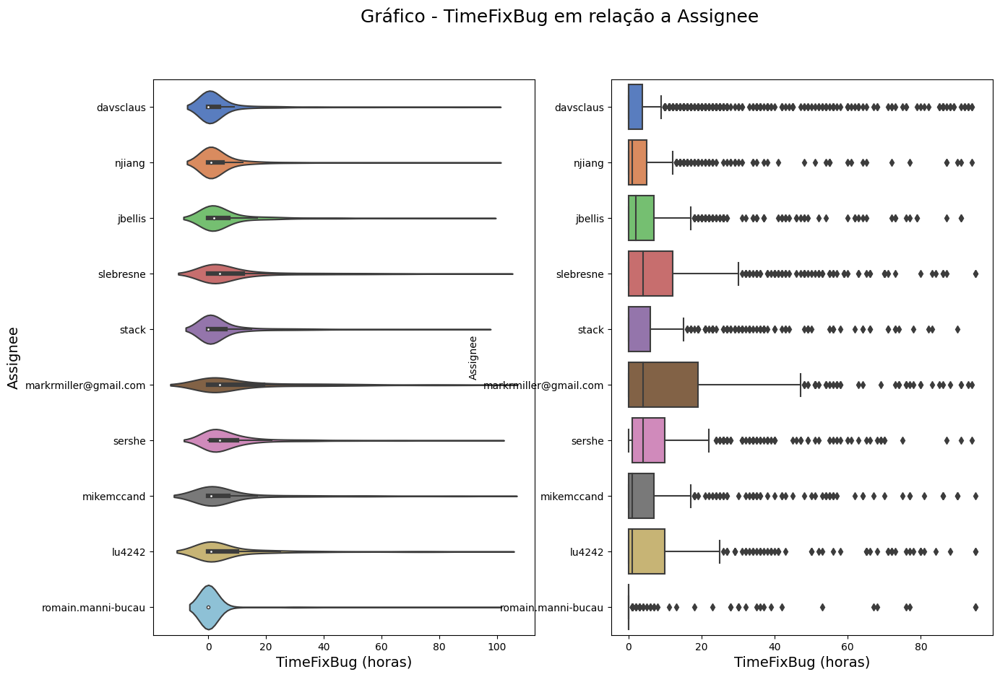

In [29]:
fig, axes = plt.subplots(1, 2, figsize = (15, 10))

sb.violinplot(x = 'TimeFixBug', y = 'Assignee',
                data = snapshot_10Assignees, 
                palette = "muted", 
                ax = axes[0])
axes[0].set_xlabel('TimeFixBug (horas)', fontsize = 14)
axes[0].set_ylabel('Assignee', fontsize = 14) 

sb.boxplot(x = 'TimeFixBug', y = 'Assignee',
                data = snapshot_10Assignees, 
                palette = "muted",
                ax = axes[1])
axes[1].set_xlabel('TimeFixBug (horas)', fontsize = 14)

fig.suptitle('Gráfico - TimeFixBug em relação a Assignee', fontsize = 18)
plt.show()

Observando, o Assignee, o id88 é que realiza atividades, no geral, com menor TimeFixBug. Outros ids em destaque de menor TimeFixBug é id644, id318, id402, id113 e id586. Essa seleção foi observando a mediana e o 3° quartil. Destaque para o id88, id318 e id113 que são os 3 Assignees mais frequentes.

Olhando para o id88, id318 e id113 podemos dizer que estes IDs são os mais engajados como um todo, quando observamos a analise de Assignee e Reporter.

# Time Series

In [11]:
grouped = snapshot_file_without_outlier.groupby(['Project', pd.Grouper(key='ResolutionDate', freq='M')])['NoCommits'].sum().reset_index().sort_values('ResolutionDate')

In [16]:
grouped["ResolutionDate"] = grouped["ResolutionDate"].dt.strftime('%m-%Y')

In [17]:
grouped

,Project,ResolutionDate,NoCommits
0,HADOOP,01-2009,0
1,HADOOP,02-2009,0
2,HADOOP,03-2009,0
3,HADOOP,04-2009,0
4,HADOOP,05-2009,0
...,...,...,...
118,HADOOP,11-2018,12
119,HADOOP,12-2018,6
347,MAPREDUCE,12-2018,2
234,HDFS,12-2018,10


In [111]:
db_total = pd.merge(commit_file, snapshot_file_without_outlier, on='Key')


In [112]:
db_total["ResolutionDate"] = pd.to_datetime(db_total["ResolutionDate"], utc=True)
db_total["CommittersLastCommitDate"] = pd.to_datetime(db_total["CommittersLastCommitDate"], utc=True)
db_total["CommittersFirstCommitDate"] = pd.to_datetime(db_total["CommittersFirstCommitDate"], utc=True)
db_total["CommitterDate"] = pd.to_datetime(db_total["CommitterDate"], utc=True)

In [113]:
(db_total["CommittersFirstCommitDate"] == db_total["ResolutionDate"]).value_counts()

False    28538
dtype: int64

In [114]:
(db_total["CommittersFirstCommitDate"] == db_total["CommittersLastCommitDate"]).value_counts()

True     24307
False     4231
dtype: int64

In [115]:
(db_total["CommittersLastCommitDate"] == db_total["ResolutionDate"]).value_counts()

False    28538
dtype: int64

In [125]:
db_total["DelayTime"] = ((db_total["ResolutionDate"] - db_total["CommittersLastCommitDate"]).dt.days)

In [126]:
db_total["DelayTime"].describe()

count    28538.000000
mean        -5.431565
std         49.380408
min      -1517.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         82.000000
Name: DelayTime, dtype: float64

In [127]:
db_total["TimeBox"] = ((db_total["ResolutionDate"] - db_total["CommittersFirstCommitDate"]).dt.days)

In [128]:
db_total["TimeBox"].describe()

count    28538.000000
mean         0.925223
std          7.522496
min       -379.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         94.000000
Name: TimeBox, dtype: float64

In [130]:
((db_total["TimeBox"] < 0) & (db_total["DelayTime"] < 0)).value_counts()

False    28057
True       481
dtype: int64

In [71]:
snapshot_file_without_outlier.NoCommitters.describe()

count    8799.000000
mean        0.815093
std         0.447284
min         0.000000
25%         1.000000
50%         1.000000
75%         1.000000
max         3.000000
Name: NoCommitters, dtype: float64

Cerca de 75% dos casos, possuem apenas um committer envolvido

In [73]:
(db_total["Committer"] == db_total["Assignee"]).value_counts()

False    21386
True      7161
dtype: int64

In [74]:
(db_total["Committer"] == db_total["Author"]).value_counts()

True     28357
False      190
dtype: int64

In [75]:
(db_total["Committer"] == db_total["Reporter"]).value_counts()

False    20820
True      7727
dtype: int64

In [77]:
((db_total["Committer"] == db_total["Assignee"]) & (db_total["Committer"] == db_total["Reporter"])).value_counts()

False    23129
True      5418
dtype: int64

# Montagem Times Series

In [132]:
db_total = db_total.rename(columns={"Project_x": "Project"})

In [133]:
grouped = db_total.groupby(['Project', pd.Grouper(key='CommitterDate', freq='M')])['Committer'].count().reset_index().sort_values('CommitterDate')

In [134]:
grouped

,Project,CommitterDate,Committer
0,HADOOP,2009-06-30 00:00:00+00:00,2
1,HADOOP,2009-07-31 00:00:00+00:00,27
2,HADOOP,2009-08-31 00:00:00+00:00,34
3,HADOOP,2009-09-30 00:00:00+00:00,48
4,HADOOP,2009-10-31 00:00:00+00:00,16
...,...,...,...
295,MAPREDUCE,2018-11-30 00:00:00+00:00,4
114,HADOOP,2018-12-31 00:00:00+00:00,9
296,MAPREDUCE,2018-12-31 00:00:00+00:00,4
206,HDFS,2018-12-31 00:00:00+00:00,16


In [136]:
grouped["CommitterDate"] = grouped["CommitterDate"].dt.strftime('%m-%Y')

In [137]:
grouped

,Project,CommitterDate,Committer
0,HADOOP,06-2009,2
1,HADOOP,07-2009,27
2,HADOOP,08-2009,34
3,HADOOP,09-2009,48
4,HADOOP,10-2009,16
...,...,...,...
295,MAPREDUCE,11-2018,4
114,HADOOP,12-2018,9
296,MAPREDUCE,12-2018,4
206,HDFS,12-2018,16


In [139]:
fig = px.line(grouped, x='CommitterDate', y="Committer", color='Project')
fig.show()